### Initialization

In [1]:
%matplotlib inline

import numpy as np

from collections import OrderedDict

import xpsi

from xpsi import PostProcessing

# choose a seed for the notebook if you want caching to be useful
# and the notebook exactly reproducible
PostProcessing.set_random_seed(0)

import matplotlib.pyplot as plt

import csv 

from xpsi.utilities.ProjectionTool import plot_projection_general
from xpsi.utilities.ProjectionTool import veneer

/=============================================\
| X-PSI: X-ray Pulse Simulation and Inference |
|---------------------------------------------|
|                Version: 2.2.2               |
|---------------------------------------------|
|      https://xpsi-group.github.io/xpsi      |
\=============================================/

Imported GetDist version: 1.4.6
Imported nestcheck version: 0.2.1


In [21]:
rc = {"font.family" : "serif",
      "mathtext.fontset" : "stix"}
plt.rcParams.update(rc)
plt.rcParams["font.serif"] = ["Times New Roman"] + plt.rcParams["font.serif"]
plt.rcParams.update({'font.size': 22})
plt.rcParams.update({'legend.fontsize': 18})
plt.rcParams.update({'axes.titlesize': 24})

In [3]:
# Cell output consists of all user specified flags followed by model parameter creation
# and likelihood value for each module loaded

import postprocessing_metadata_ST_PDT_3C50 as ppm

Parsing configuration file...
--main-import-statements
from xpsi.global_imports import gravradius
import math
import numpy as np
--prior-import-statements
import math
import numpy as np
from scipy.stats import truncnorm
from scipy.interpolate import Akima1DInterpolator
from xpsi.global_imports import _G, _csq, _km, _2pi, gravradius, _dpr
from xpsi import Parameter
from xpsi.PostProcessing import fix_random_seed
from xpsi.cellmesh.mesh_tools import eval_cedeCentreCoords
from xpsi.PostProcessing import fix_random_seed
xpsi.PostProcessing.set_random_seed(0)
--XTI-exposure-time=1.310083E+06
--XTI-count-matrix-path=/Users/dc1408/PhD_research/J0437/3c50/j0437_3c50_cl_evt_merged_phase_converted_to_counts.txt
--XTI-event-path=/Users/dc1408/PhD_research/J0437/3c50/j0437_3c50_cl_evt_merged_phase.txt
--XTI-number-phase-bins=32
--XTI-event-file-channel-column=1
--XTI-event-file-phase-column=2
--XTI-event-file-skiprows=3
--XTI-arf-path=/Users/dc1408/PhD_research/J0437/3c50/nicer-consim135p-teamonly

### Likelihood values 
(copied values from print statements above)
- 3C50_NoBKG log-likelihood value:  `-35543.246925275045`
- 3C50_BKG_lower_smooth_3sigma log-likelihood value:  `-35543.154085882845`
- 3C50_BKG_AGN_smooth_3sigma log-likelihood value:  `-35576.76936154372`

## Posterior plots

In [4]:
pp = xpsi.PostProcessing.CornerPlotter([ppm.main_3C50_NoBKG.runs,
                                        ppm.main_3C50_BKG_lower_smooth_3sigma.runs,
                                        ppm.main_3C50_BKG_AGN_smooth_3sigma.runs])

In [5]:
## Parameters to plot and colour selection

cm = plt.get_cmap('inferno')  #inferno, gist_earth cividis, cubehelix
nColors = 8
mycolors1 = [cm(xcol) for xcol in np.linspace(0, 1, nColors)]
mycolors2 = ['#0C1346', '#008F7B', '#7B008F', '#CC8300']

params_spacetime=['radius','compactness','mass']

params_geom = ['radius','mass',
               'cos_inclination',
               'p__super_colatitude',
               'p__phase_shift',
               'p__super_radius',
               'p__super_temperature',
               's__super_colatitude',
               's__phase_shift_shifted',
               's__super_radius',
               's__super_temperature',
               's__cede_colatitude',
               's__cede_azimuth',
               's__cede_radius',
               's__cede_temperature']

params_others = ['radius','mass',
                 'XTI__energy_independent_effective_area_scaling_factor',
                 'N_H_e20_units']

params_all = ['radius','compactness','mass',
             'cos_inclination',
             'p__super_colatitude',
             'p__phase_shift',
             'p__super_radius',
             'p__super_temperature',
             's__super_colatitude',
             's__phase_shift_shifted',
             's__super_radius',
             's__super_temperature',
             's__cede_colatitude',
             's__cede_azimuth',
             's__cede_radius',
             's__cede_temperature',
             'XTI__energy_independent_effective_area_scaling_factor',
             'N_H_e20_units']

### Figure 6

Executing posterior density estimation...
Curating set of runs for posterior plotting...
Run set curated.
Constructing lower-triangle posterior density plot via Gaussian KDE:
plotting:  ['radius', 'compactness']
plotting:  ['radius', 'mass']
plotting:  ['compactness', 'mass']
Applying bespoke parameter viewing intervals...
Viewing intervals applied.
Veneering spines and axis ticks...
Veneered.
Adding parameter truth crosshairs...
Added crosshairs.
Adding 1D marginal credible intervals...
Plotting credible regions for posterior 3C50, No BKG...
radius   CI$_{68\%} = 10.135/-0.320/+0.333$...
radius   CI$_{90\%} = 10.135/-0.507/+0.551$...
radius   CI$_{95\%} = 10.135/-0.591/+0.654$...
compactness   CI$_{68\%} = 0.20662/-0.00660/+0.00511$...
compactness   CI$_{90\%} = 0.20662/-0.01098/+0.00780$...
compactness   CI$_{95\%} = 0.20662/-0.01300/+0.00889$...
mass   CI$_{68\%} = 1.4139/-0.0292/+0.0295$...
mass   CI$_{90\%} = 1.4139/-0.0435/+0.0438$...
mass   CI$_{95\%} = 1.4139/-0.0488/+0.0490$..

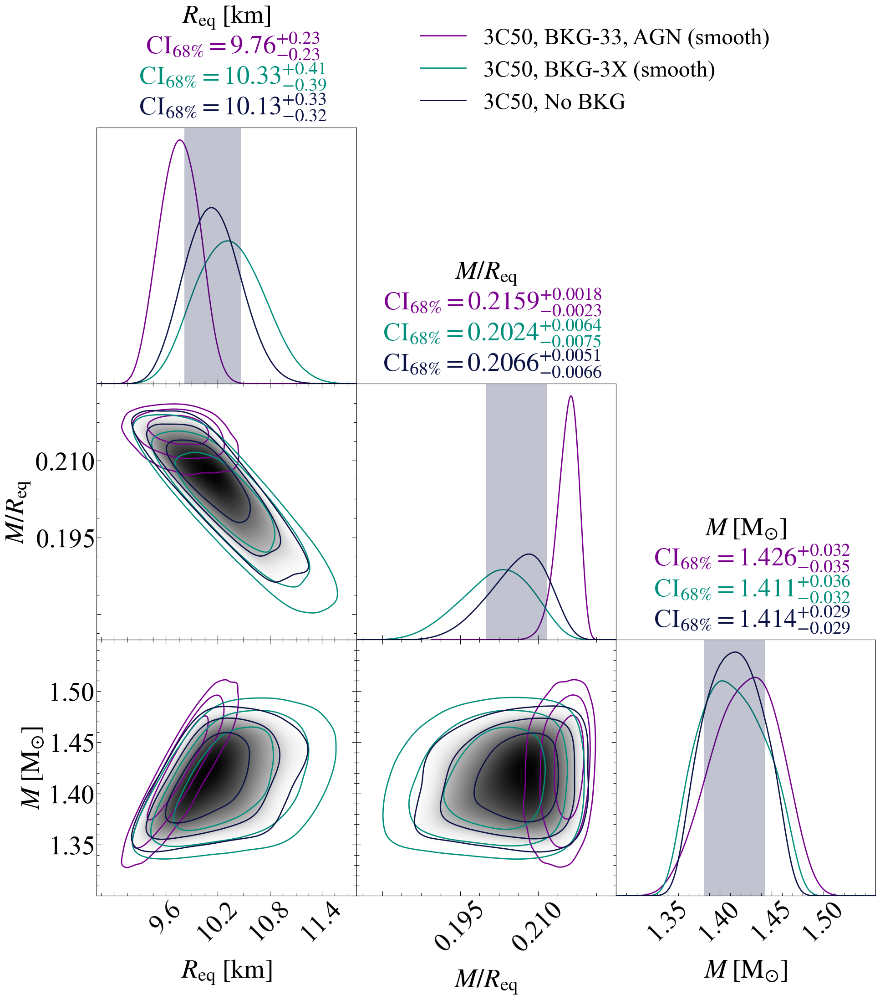

In [6]:
_ = pp.plot(
     params=params_spacetime,
     IDs=OrderedDict([(r"3C50, No BKG", ['run1']),
                      (r"3C50, BKG-3X (smooth)", ['run1']),
                      (r"3C50, BKG-33, AGN (smooth)", ['run1'])]),
     prior_density=True,      # Toggle False to quickly plot only posterior without priors
     KL_divergence=False,
     ndraws=5e4,
     force_draw=[False,False,False],     
     priors_identical=True,
     prior_samples_fnames = ["ST_PDT_spacetime_params_3C50_BKG_effects_5e4draws.npy"],
     combine=False, combine_all=False, only_combined=False, overwrite_combined=False,
     param_plot_lims={'radius': (8.8,11.8), 'compactness': (0.175,0.225), 'mass': (1.3,1.55 )},
     bootstrap_estimators=False,
     bootstrap_density=False,
     n_simulate=200,
     crosshairs=True,
     credible_interval_1d=True,
     credible_interval_1d_all_show = True,
     annotate_credible_interval=True,
     compute_all_intervals=True,
     sixtyeight=True,
     axis_tick_x_rotation=45.0,
     num_plot_contours=3,
     subplot_size=6.5,
     legend_corner_coords=(0.45,0.975),
     legend_frameon=False,
     scale_attrs=OrderedDict([('legend_fontsize', 3.0),
                              ('axes_labelsize', 3.0),
                              ('axes_fontsize', 'axes_labelsize'),
                             ]
                            ),
     line_colors=mycolors2,
     colormap='binary',#,'Reds','Blues','Purples'],
     shaded=-1,
     rasterized_shade=True,
     no_ylabel=True,
     no_ytick=True,
     lw=2.0,
     lw_1d=2.0,
     #ls= ['-'],#,'-','-','-','--'],
     #contour_ls= ['-','-','-','-','--'],#'--',#'-','-','-'],
     filled=False,
     normalize=True,
     veneer=True,
     tqdm_kwargs={'disable': False},
     lengthen=2.0,
     embolden=1.0,
     nx=500,
     scale_ymax=1.1,
     write=False,
     ext='.png',
     maxdots=3000,
     root_filename='ST_PDT_spacetime_params_3C50_BKG_effects')

plt.savefig("./ST_PDT_spacetime_params_3C50_BKG_effects.pdf", format='pdf', bbox_inches='tight')
plt.savefig("./ST_PDT_spacetime_params_3C50_BKG_effects_dpi70.png", format='png', bbox_inches='tight', dpi=70)

### Figure B.5 (ApJL; numbered 21 in arXiv)

In [7]:
_ = pp.plot(
     params=params_all,
     precisions=[None,None,None,None,None,None,3,None,None,3,4,None,2,None,None,None,None,None],
     IDs=OrderedDict([(r"3C50, No BKG", ['run1']),
                      (r"3C50, BKG-3X (smooth)", ['run1']),
                      (r"3C50, BKG-33, AGN (smooth)", ['run1'])]),
     prior_density=True,      # Toggle False to quickly plot only posterior without priors
     KL_divergence=False,
     ndraws=5e4,
     force_draw=[False,False,False],     
     priors_identical=True,
     prior_samples_fnames = ["ST_PDT_all_params_3C50_BKG_effects_5e4draws.npy"],
     combine=False, combine_all=False, only_combined=False, overwrite_combined=False,
     param_plot_lims={'radius': (8.8,11.8), 'compactness': (0.175,0.225), 'mass': (1.3,1.55 ),
                      'p__super_radius': (0.0, 0.5),
                      's__cede_radius': (0.0, 0.7), 's__cede_temperature': (5.5, 6.0)},
     bootstrap_estimators=False,
     bootstrap_density=False,
     n_simulate=200,
     crosshairs=True,
     credible_interval_1d=True,
     credible_interval_1d_all_show = True,
     annotate_credible_interval=True,
     compute_all_intervals=True,
     sixtyeight=True,
     axis_tick_x_rotation=45.0,
     num_plot_contours=3,
     subplot_size=6.5,
     legend_corner_coords=(0.5,0.675),
     legend_frameon=False,
     scale_attrs=OrderedDict([('legend_fontsize', 9.0),
                              ('axes_labelsize', 3.2),
                              ('axes_fontsize', 'axes_labelsize'),
                             ]
                            ),
     line_colors=mycolors2,
     colormap='binary',#,'Reds','Blues','Purples'],
     shaded=-1,
     rasterized_shade=True,
     no_ylabel=True,
     no_ytick=True,
     lw=2.0,
     lw_1d=2.0,
     #ls= ['-'],#,'-','-','-','--'],
     #contour_ls= ['-','-','-','-','--'],#'--',#'-','-','-'],
     filled=False,
     normalize=True,
     veneer=True,
     tqdm_kwargs={'disable': False},
     lengthen=2.0,
     embolden=1.0,
     nx=500,
     scale_ymax=1.1,
     write=False,
     ext='.png',
     maxdots=3000,
     root_filename='ST_PDT_all_params_3C50_BKG_effects')

plt.savefig("./ST_PDT_all_params_3C50_BKG_effects.pdf", format='pdf', bbox_inches='tight')
plt.savefig("./ST_PDT_all_params_3C50_BKG_effects_dpi70.png", format='png', bbox_inches='tight', dpi=70)

Executing posterior density estimation...
Curating set of runs for posterior plotting...
Run set curated.
Constructing lower-triangle posterior density plot via Gaussian KDE:
plotting:  ['radius', 'compactness']
plotting:  ['radius', 'mass']
plotting:  ['radius', 'cos_inclination']
plotting:  ['radius', 'p__super_colatitude']
plotting:  ['radius', 'p__phase_shift']
plotting:  ['radius', 'p__super_radius']
plotting:  ['radius', 'p__super_temperature']
plotting:  ['radius', 's__super_colatitude']
plotting:  ['radius', 's__phase_shift_shifted']
plotting:  ['radius', 's__super_radius']
plotting:  ['radius', 's__super_temperature']
plotting:  ['radius', 's__cede_colatitude']
plotting:  ['radius', 's__cede_azimuth']
plotting:  ['radius', 's__cede_radius']
plotting:  ['radius', 's__cede_temperature']
plotting:  ['radius', 'XTI__energy_independent_effective_area_scaling_factor']
plotting:  ['radius', 'N_H_e20_units']
plotting:  ['compactness', 'mass']
plotting:  ['compactness', 'cos_inclinatio

## Conditional posterior signal plots

In [8]:
pp = xpsi.PostProcessing.SignalPlotter([ppm.main_3C50_NoBKG.runs,
                                        ppm.main_3C50_BKG_lower_smooth_3sigma.runs,
                                        ppm.main_3C50_BKG_AGN_smooth_3sigma.runs])

### Residual plots

In [9]:
xpsi.ResidualPlot.declare_settings(extension='.pdf',
                                   yticks=[[30,100],None,[30,100],None,[30,100],None],
                                   fscale=1.5)

Declaring plot class settings...
Settings declared.


Instantiating a residual plotter for posterior checking...
Residual plotter instantiated.
Plotting signals for posterior checking...
Curating set of runs for posterior plotting...
Run set curated.
Handling posterior 3C50, No BKG...
Checking whether an existing cache can be read:
Creating new cache file...
Initialising cache file...
Cache file initialised.
Cache file created.
Cache state determined.


Signal caching loop:   0%|          | 0/200 [00:00<?, ?it/s]

ResidualPlot object iterating over samples...
ResidualPlot object finished iterating.
ResidualPlot object finalizing...
ResidualPlot object finalized.
Writing plot to disk...
ResidualPlot instance plot will be written to path ./3C50,_No_BKG.run1__signalplot_residuals.pdf...
Written.
Handled posterior 3C50, No BKG.
Plotted signals for posterior checking.


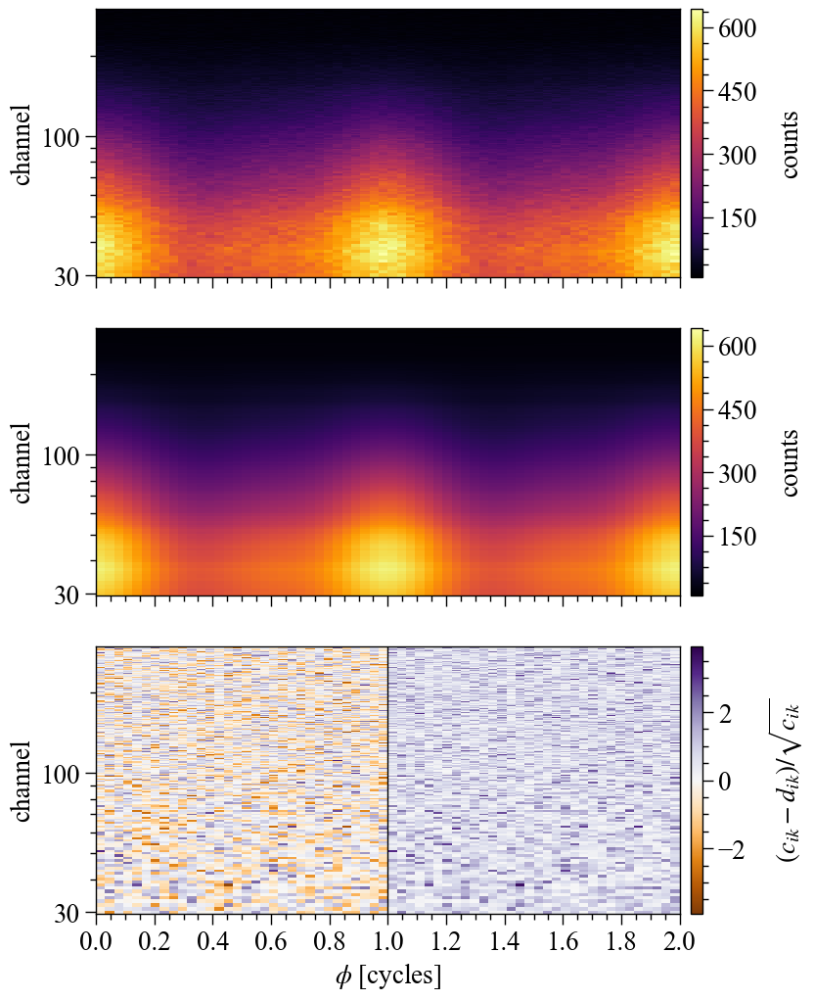

In [10]:
pp.plot(IDs=OrderedDict([(r"3C50, No BKG", ['run1'])]),
        force_cache=False,
        combine=False, # use these controls if more than one run for a posterior
        combine_all=False,
        force_combine=False,
        only_combined=False,
        nsamples=200,
        plots = {r"3C50, No BKG": xpsi.ResidualPlot()})

pp.plots[r"3C50, No BKG"].fig

Instantiating a residual plotter for posterior checking...
Residual plotter instantiated.
Plotting signals for posterior checking...
Curating set of runs for posterior plotting...
Run set curated.
Handling posterior 3C50, BKG-3X (smooth)...
Checking whether an existing cache can be read:
Creating new cache file...
Attempting to archive existing cache file in a subdirectory...
Targeting subdirectory: ./archive.
Exisiting cache file archived in subdirectory ./archive.
Initialising cache file...
Cache file initialised.
Cache file created.
Cache state determined.


Signal caching loop:   0%|          | 0/200 [00:00<?, ?it/s]

ResidualPlot object iterating over samples...
ResidualPlot object finished iterating.
ResidualPlot object finalizing...
ResidualPlot object finalized.
Writing plot to disk...
ResidualPlot instance plot will be written to path ./3C50,_BKG-3X_(smooth).run1__signalplot_residuals.pdf...
Written.
Handled posterior 3C50, BKG-3X (smooth).
Plotted signals for posterior checking.


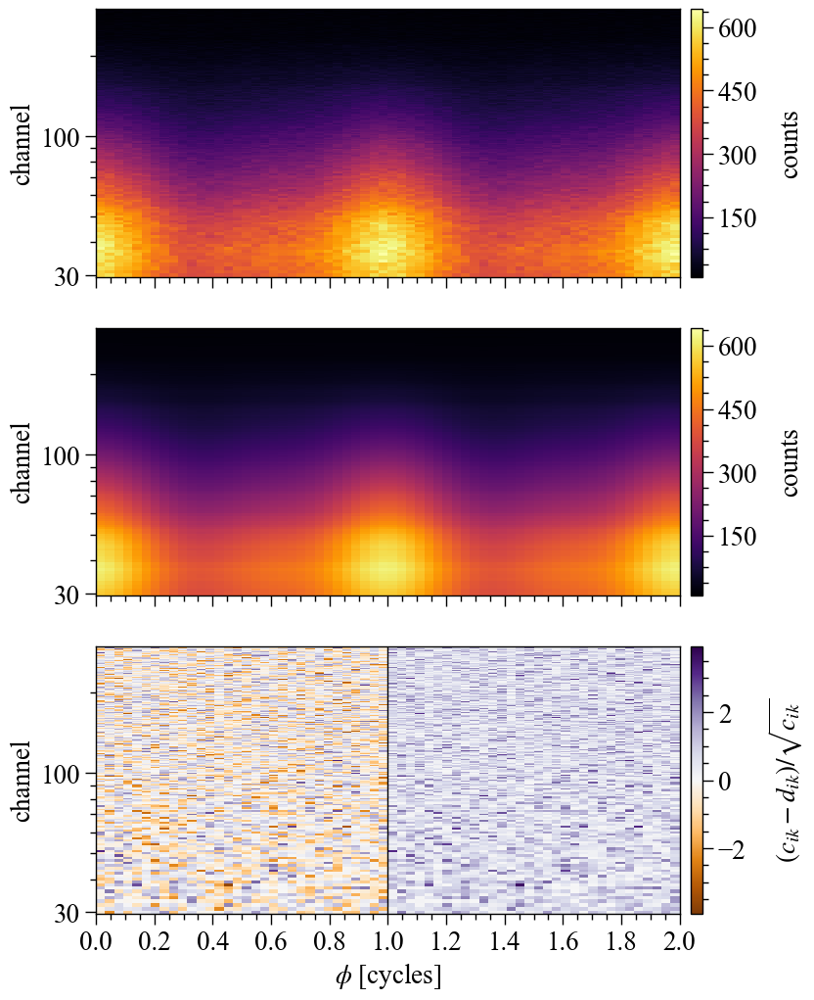

In [11]:
pp.plot(IDs=OrderedDict([(r"3C50, BKG-3X (smooth)", ['run1'])]),
        force_cache=False,
        combine=False, # use these controls if more than one run for a posterior
        combine_all=False,
        force_combine=False,
        only_combined=False,
        nsamples=200,
        plots = {r"3C50, BKG-3X (smooth)": xpsi.ResidualPlot()})

pp.plots[r"3C50, BKG-3X (smooth)"].fig

Instantiating a residual plotter for posterior checking...
Residual plotter instantiated.
Plotting signals for posterior checking...
Curating set of runs for posterior plotting...
Run set curated.
Handling posterior 3C50, BKG-33, AGN (smooth)...
Checking whether an existing cache can be read:
Creating new cache file...
Attempting to archive existing cache file in a subdirectory...
Targeting subdirectory: ./archive.
Exisiting cache file archived in subdirectory ./archive.
Initialising cache file...
Cache file initialised.
Cache file created.
Cache state determined.


Signal caching loop:   0%|          | 0/200 [00:00<?, ?it/s]

ResidualPlot object iterating over samples...
ResidualPlot object finished iterating.
ResidualPlot object finalizing...
ResidualPlot object finalized.
Writing plot to disk...
ResidualPlot instance plot will be written to path ./3C50,_BKG-33,_AGN_(smooth).run1__signalplot_residuals.pdf...
Written.
Handled posterior 3C50, BKG-33, AGN (smooth).
Plotted signals for posterior checking.


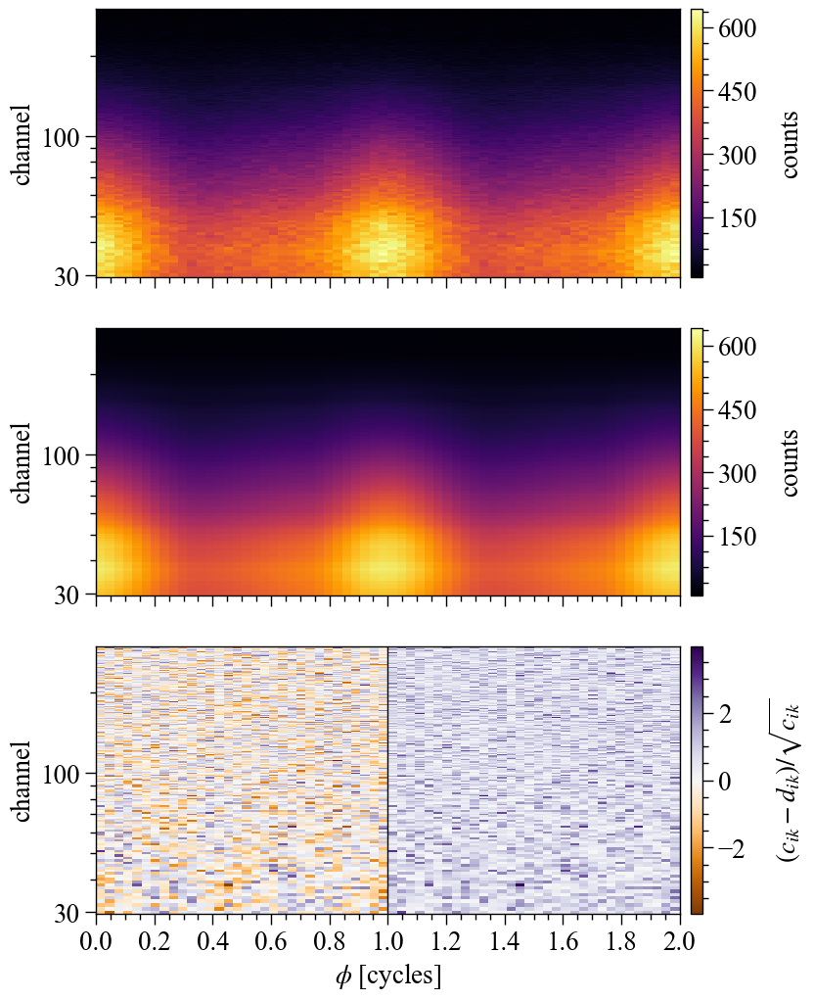

In [12]:
pp.plot(IDs=OrderedDict([(r"3C50, BKG-33, AGN (smooth)", ['run1'])]),
        force_cache=False,
        combine=False, # use these controls if more than one run for a posterior
        combine_all=False,
        force_combine=False,
        only_combined=False,
        nsamples=200,
        plots = {r"3C50, BKG-33, AGN (smooth)": xpsi.ResidualPlot()})

pp.plots[r"3C50, BKG-33, AGN (smooth)"].fig

### Pulse profile plots

Since these kind of plots are not reported in the paper, we only provide an example routine of how to generate such plots.

In [11]:
xpsi.PulsePlot.declare_settings(extension='.pdf')

Declaring plot class settings...
Settings declared.


Instantiating a pulse-profile plotter for posterior checking...
Pulse-profile plotter instantiated.
Plotting signals for posterior checking...
Curating set of runs for posterior plotting...
Run set curated.
Handling posterior 3C50, No BKG...
Checking whether an existing cache can be read:
Creating new cache file...
Initialising cache file...
Cache file initialised.
Cache file created.
Cache state determined.


Signal caching loop:   0%|          | 0/200 [00:00<?, ?it/s]

PulsePlot object iterating over samples...
Adding credible intervals on the incident photon flux signal as function of phase...


  0%|          | 0/200 [00:00<?, ?it/s]

  0%|          | 0/999 [00:00<?, ?it/s]

Credible intervals added.
Added conditional posterior contours for incident signal.
Adding credible intervals on the count-rate signal as function of phase...


  0%|          | 0/200 [00:00<?, ?it/s]

  0%|          | 0/999 [00:00<?, ?it/s]

Credible intervals added.
Added conditional posterior contours for registered signal.
PulsePlot object finished iterating.
PulsePlot object finalizing...
PulsePlot object finalized.
Writing plot to disk...
PulsePlot instance plot will be written to path ./ST_PDT_3C50_NoBKG_signal__3C50,_No_BKG.run1__signalplot_pulse.pdf...
Written.
Handled posterior 3C50, No BKG.
Plotted signals for posterior checking.


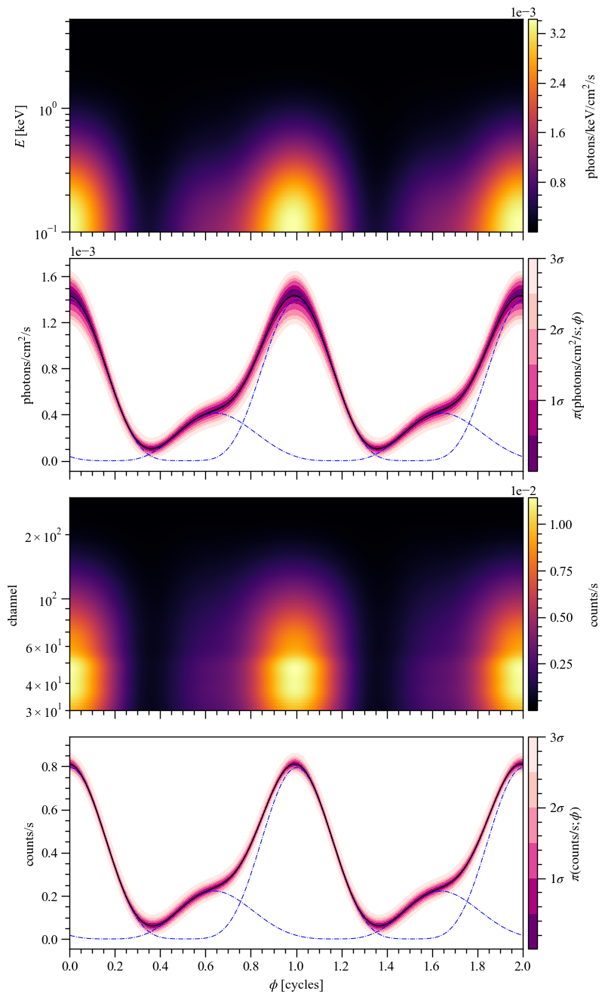

In [12]:
pp.plot(IDs=OrderedDict([(r"3C50, No BKG", ['run1']),]),
        nsamples=200,
        force_cache=False,
        plots = {r"3C50, No BKG": xpsi.PulsePlot(use_fgivenx=True,
                                                 comp_expectation_line_kwargs=dict(color='b',
                                                                 ls='-.',
                                                                 lw=0.75,
                                                                 alpha=1.0),
                                                 show_components=True,
                                                 write=True,
                                                 fig_dir='.',
                                                 root_filename= 'ST_PDT_3C50_NoBKG_signal'
                                                 ),})

pp.plots[r"3C50, No BKG"].fig

### Spectrum plots

Since these kind of plots are not reported in the paper, we only provide an example routine of how to generate such plots.

In [13]:
xpsi.SpectrumPlot.declare_settings(extension='.pdf')

Declaring plot class settings...
Settings declared.


Instantiating a spectrum plotter for posterior checking...
Spectrum plotter instantiated.
Plotting signals for posterior checking...
Curating set of runs for posterior plotting...
Run set curated.
Handling posterior 3C50, No BKG...
Checking whether an existing cache can be read:
Creating new cache file...
Initialising cache file...
Cache file initialised.
Cache file created.
Cache state determined.


Signal caching loop:   0%|          | 0/200 [00:00<?, ?it/s]

SpectrumPlot object iterating over samples...
Adding credible intervals on the incident specific photon flux spectrum...


  0%|          | 0/200 [00:00<?, ?it/s]

  0%|          | 0/256 [00:00<?, ?it/s]

Credible intervals added.
Adding credible intervals on the count-rate spectrum...


  0%|          | 0/200 [00:00<?, ?it/s]

  0%|          | 0/270 [00:00<?, ?it/s]

Credible intervals added.
Added conditional posterior contours for incident spectrum.
SpectrumPlot object finished iterating.
SpectrumPlot object finalizing...
SpectrumPlot object finalized.
Writing plot to disk...
SpectrumPlot instance plot will be written to path ./ST_PDT_3C50_NoBKG_spectrum__3C50,_No_BKG.run1__signalplot_spectrum.pdf...
Written.
Handled posterior 3C50, No BKG.
Plotted signals for posterior checking.


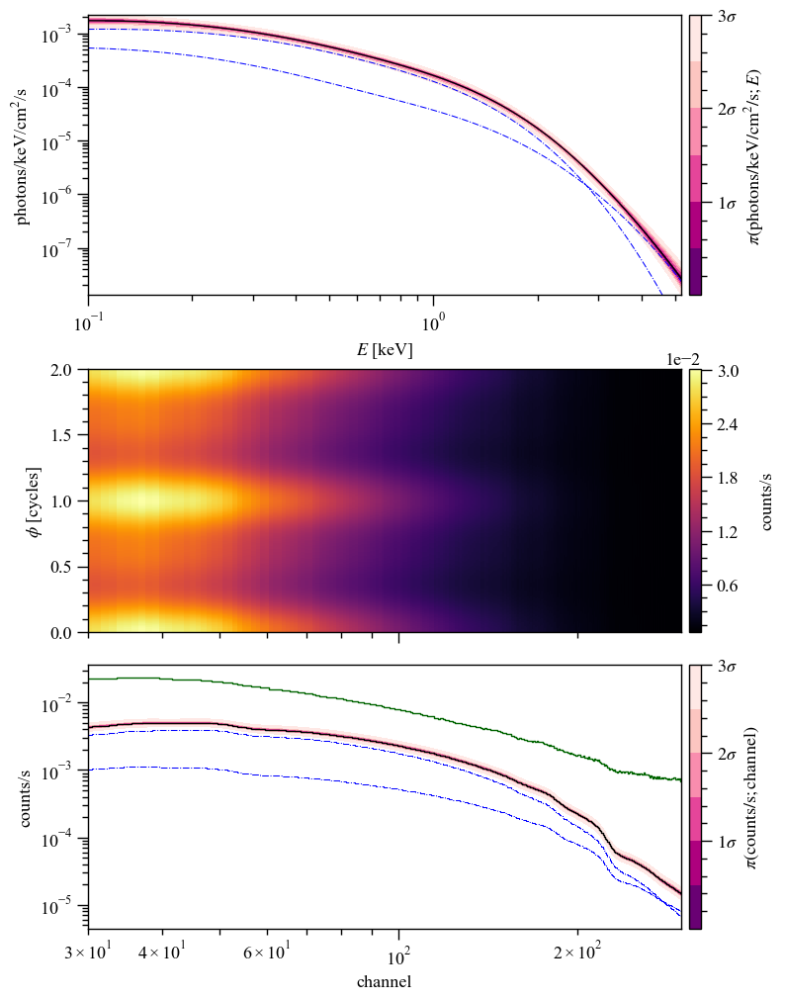

In [14]:
pp.plot(IDs=OrderedDict([(r"3C50, No BKG", ['run1']),]),
        
        nsamples=200,
        force_cache=False,
        plots = {r"3C50, No BKG": xpsi.SpectrumPlot(use_fgivenx=True,
                                                    rel_num_energies=2.0,
                                                    add_background=True,
                                                    background_line_kwargs=dict(color='darkgreen',
                                                                                ls='-',
                                                                                lw=1.0,
                                                                                alpha=1.0),
                                                    expectation_line_kwargs=dict(color='k',
                                                                                 ls='-',
                                                                                 lw=1.0,
                                                                                 alpha=1.0),
                                                    sample_line_kwargs=dict(color='pink',
                                                                            ls='-',
                                                                            lw=0.05,
                                                                            alpha=1.0),
                                                    comp_expectation_line_kwargs=dict(color='b',
                                                                                      ls='-.',
                                                                                      lw=0.75,
                                                                                      alpha=1.0),
                                                    show_attenuated=False,
                                                    show_components=True,
                                                    write=True,
                                                    fig_dir='.',
                                                    root_filename= 'ST_PDT_3C50_NoBKG_spectrum',
                                                    )})

pp.plots[r"3C50, No BKG"].fig

# ML geometry projections

### Earth PoV

YOU ARE USING A 2 HOT SPOT MODEL
YOU ARE USING A 2 HOT SPOT MODEL
YOU ARE USING A 2 HOT SPOT MODEL


<AxesSubplot: >

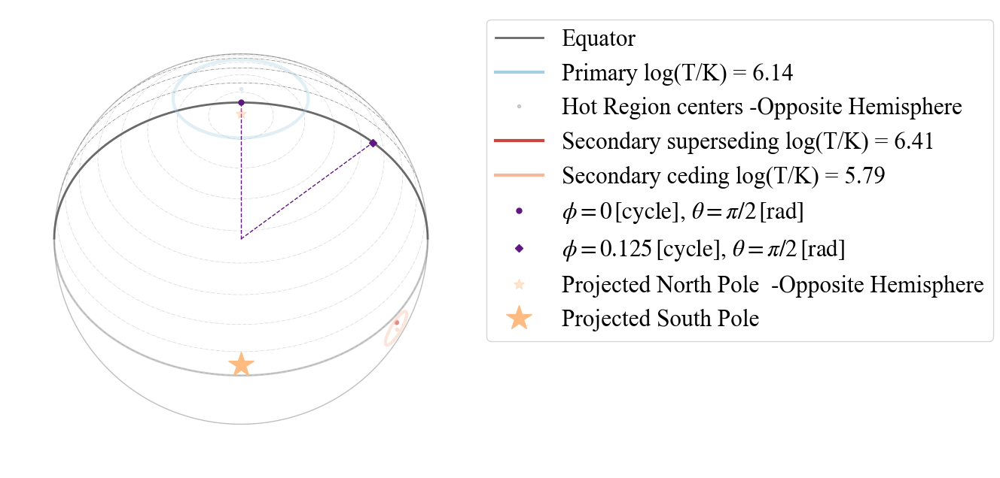

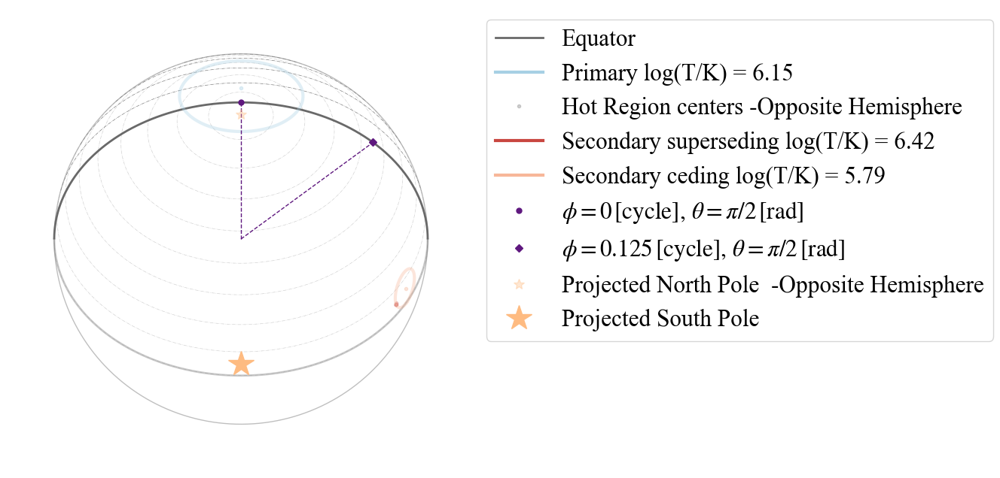

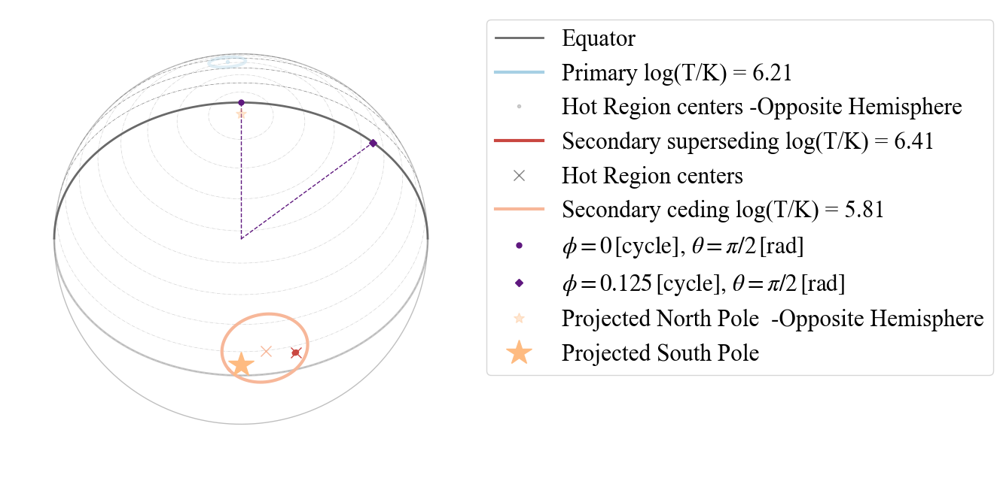

In [15]:
plot_projection_general(ppm.main_3C50_NoBKG.likelihood,"ST+PDT","I","NP",
                        antiphase = True, SaveFlag = True, dir = "./", 
                        Name = "3C50_NoBKG_ML", extension = ".pdf")

plot_projection_general(ppm.main_3C50_BKG_lower_smooth_3sigma.likelihood,"ST+PDT","I","NP",
                        antiphase = True, SaveFlag = True, dir = "./", 
                        Name = "3C50_BKG_lower_smooth_3sigma_ML", extension = ".pdf")

plot_projection_general(ppm.main_3C50_BKG_AGN_smooth_3sigma.likelihood,"ST+PDT","I","NP",
                        antiphase = True, SaveFlag = True, dir = "./", 
                        Name = "3C50_BKG_AGN_smooth_3sigma_ML", extension = ".pdf")

### North Pole PoV

YOU ARE USING A 2 HOT SPOT MODEL
YOU ARE USING A 2 HOT SPOT MODEL
YOU ARE USING A 2 HOT SPOT MODEL


<AxesSubplot: >

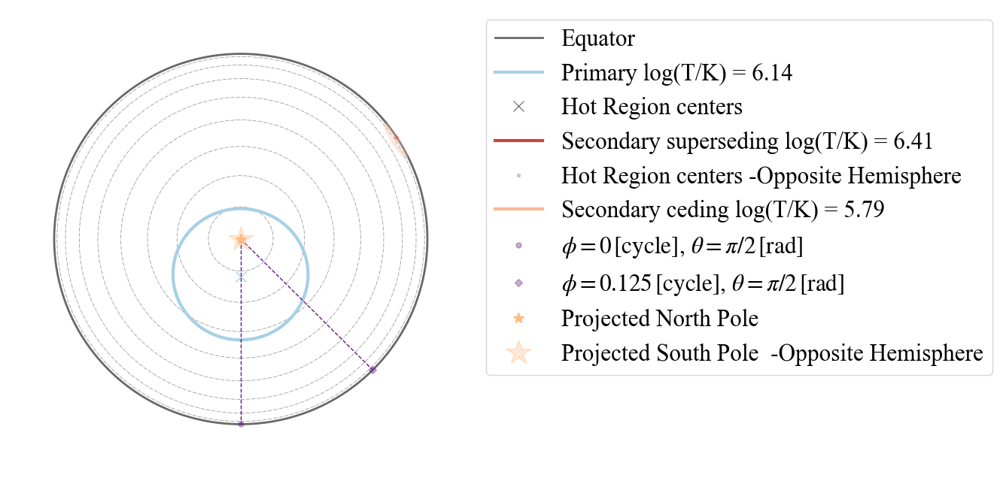

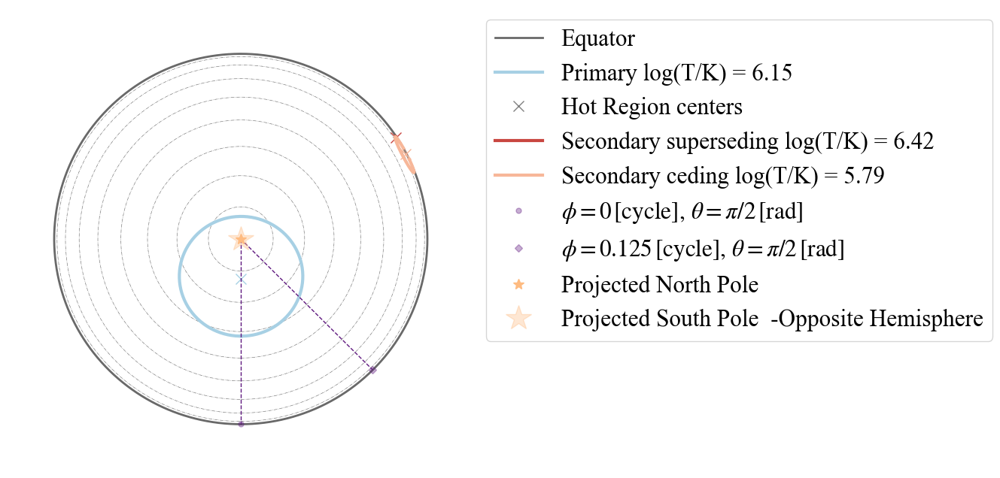

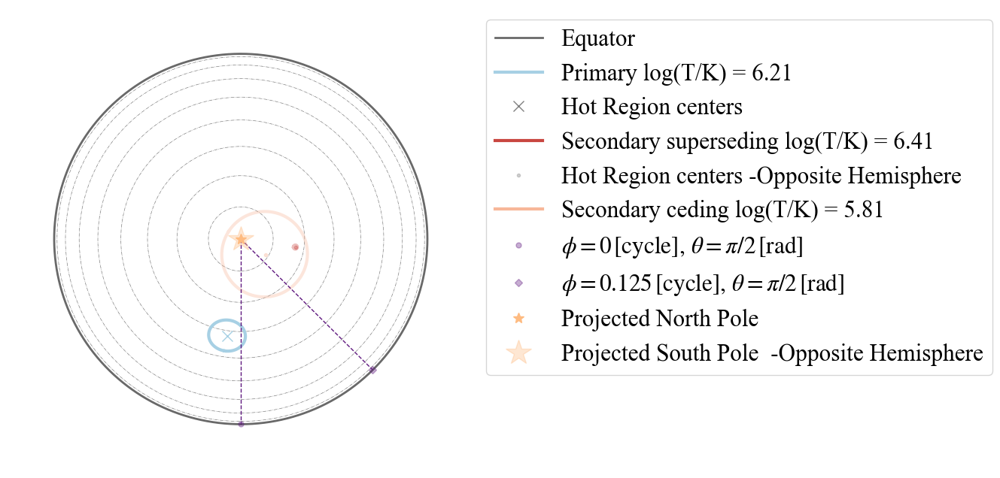

In [16]:
plot_projection_general(ppm.main_3C50_NoBKG.likelihood,"ST+PDT",[0,0,1],"NP",
                        antiphase = True, SaveFlag = True, dir = "./", 
                        Name = "3C50_NoBKG_ML", POVname='NorthPole', extension = ".pdf")

plot_projection_general(ppm.main_3C50_BKG_lower_smooth_3sigma.likelihood,"ST+PDT",[0,0,1],"NP",
                        antiphase = True, SaveFlag = True, dir = "./", 
                        Name = "3C50_BKG_lower_smooth_3sigma_ML", POVname='NorthPole', extension = ".pdf")

plot_projection_general(ppm.main_3C50_BKG_AGN_smooth_3sigma.likelihood,"ST+PDT",[0,0,1],"NP",
                        antiphase = True, SaveFlag = True, dir = "./", 
                        Name = "3C50_BKG_AGN_smooth_3sigma_ML", POVname='NorthPole', extension = ".pdf")

## Background

In [17]:
def extract_BKG(p, main, INST='NICER'):
    main.likelihood(p, reinitialise=True)
    if INST=='NICER':
        try:
            signal = main.signal
        except AttributeError:
            signal = main.signals[0][0]
    elif INST=='MOS1':
        signal = main.signals[0][1]
    elif INST=='MOS2':
        signal = main.signals[0][2]
    else:
        raise ValueError("Invalid instrument")
    return signal.background_signal_given_support

In [18]:
def SAVE_BKG(BKG, file_identifier=""):
    BKG_FILE = "BKG_FILE_"+file_identifier+".txt"
    new_file = open(BKG_FILE, "w") 
    writer = csv.writer(new_file, delimiter='\t')
    writer.writerow(BKG)
    new_file.close()

In [19]:
def plot_spectrum_GEN(main, BestFitP, PATH_dir, PATH_outfile, out_dir, file_identifier, format='png', 
                      BKG_LowerLimit=False, BKG_UpperLimit=False, AGN=False,  Nsamples = 20, AmpF=1):
    """
    main: provide main file over which to run
    BestFitP: Max likelihood parameter vector
    PATH_dir: base directory of MN output files
    PATH_outfile: Location of MN output files
    out_dir: Output directory for BKG plot
    file_identifier: File name for BKG plot
    format: file format
    AGN: bool: Set true if AGN estimate is used
    BKG_UpperLimit: bool: Set true if bkg upper limit is used
    Nsamples: samples over which to evaluate the mean and std of the BKG
    AmpF: amplification factor for BKG
    """
    BKG = extract_BKG(BestFitP, main)
    SAVE_BKG(BKG, file_identifier)
    
    cmA = ['RdPu','BuPu','YlGnBu', 'bone_r']
    REFinst = []
    ii = 1

    try:
        s0 = np.sum(main.XTI.signal.signals[0], axis=1)/float(len(main.XTI.signal.phases[0]))*main.XTI.data.exposure_time
        s1 = np.sum(main.XTI.signal.signals[1], axis=1)/float(len(main.XTI.signal.phases[0]))*main.XTI.data.exposure_time
        expected = main.XTI.signal.expected_counts.sum(axis = 1) 
        data_matrix = np.loadtxt(main.args.XTI_count_matrix_path)
        REFinst = main.XTI
    except AttributeError:
        s0 =np.sum(main.XTI.signals[0][0].signals[0], axis=1)/float(len(main.XTI.signals[0][0].phases[0]))*main.XTI.data.exposure_time
        s1 =np.sum(main.XTI.signals[0][0].signals[1], axis=1)/float(len(main.XTI.signals[0][0].phases[0]))*main.XTI.data.exposure_time
        expected = main.XTI.signals[0][0].expected_counts.sum(axis = 1) 
        data_matrix = np.loadtxt(main.args.XTI_count_matrix_path)
        REFinst = main.XTI.instrument
    data_to_plot =(data_matrix.sum(axis=1))

    SIG = s0+s1
    SIG_BKG = s0+s1+BKG
    
    x0 = REFinst.data._channels
    
    dataA = np.loadtxt(PATH_dir+PATH_outfile+'post_equal_weights.dat')
    indexR = np.random.randint(low=0, high=len(dataA)-1, size=Nsamples)
    BKG_A = []
    for i in range(Nsamples):
        pi = dataA[indexR[i]]
        BKG_i = extract_BKG(pi[:-1], main)
        BKG_A.append(BKG_i)
    BKG_A = np.array(BKG_A)
    
    sigma = np.std(BKG_A,axis = 0)
    mean = np.mean(BKG_A,axis = 0)
    print ("max BKG std over channels: ",np.max(sigma))
    
    fig = plt.figure(figsize=(10,8))
    ax = fig.add_subplot(111)
    
    cm = plt.get_cmap(cmA[ii]) 
    nColors = 9 
    mycolors = [cm(xcol) for xcol in np.linspace(0,1 , nColors)]
    
    ax.grid(linestyle="-.", color='grey',linewidth=0.7)
    veneer(None,None, ax)
    
    ax.set_ylabel(r"Spectrum [counts]")
    ax.set_xlabel("Channels",)
    
    lBs = r'$\mathrm{Inferred\, BKG\, MEAN\pm 1\sigma}$' if AmpF ==1 else r'$\mathrm{BKG\, MEAN\pm 1\sigma \times %i}$'%AmpF
    lBp = 'Inferred BKG@MaxL'  if AmpF ==1 else r'BKG $\times %i$ @MaxL'%AmpF
    
    ax.fill_between(x0, np.abs(mean-1*sigma)*AmpF, (mean+1*sigma)*AmpF, color =mycolors[7],alpha = 0.5,label =lBs)
    ax.fill_between(x0, np.abs(mean-2*sigma)*AmpF, (mean+2*sigma)*AmpF, color =mycolors[7],alpha = 0.4,label =lBs.replace('1\sigma','2\sigma'))
    ax.fill_between(x0, np.abs(mean-3*sigma)*AmpF, (mean+3*sigma)*AmpF, color =mycolors[7],alpha = 0.3,label =lBs.replace('1\sigma','3\sigma'))
    ax.plot(x0,BKG*AmpF,color =mycolors[6],label = lBp,lw = 2)
    
    ax.fill_between(x0, np.zeros(len(x0)),s0,color =mycolors[1],alpha = 0.5,label ='Primary@MaxL')
    ax.fill_between(x0, s0,SIG, color =mycolors[2],alpha = 0.5,label ='Secondary@MaxL')
    ax.fill_between(x0, SIG, SIG_BKG, color =mycolors[3],alpha = 0.5,label ='BKG@MaxL')
    
    ax.plot(x0,expected, color =mycolors[4],lw = 3,label ='Expected signal')

    if AGN:
        ax.plot(x0, main.agn_3c50[:,1]*REFinst.data.exposure_time, '-.', color='darkslategrey', lw = 2, label='3C50 AGN')

    if BKG_LowerLimit or BKG_UpperLimit:
        BKG_spectrum_data = main.spectrum*REFinst.data.exposure_time
        ax.plot(x0,BKG_spectrum_data*AmpF,'-.', color =mycolors[5], lw = 2,label = r"3C50 BKG")

    if BKG_LowerLimit:
        bkg_low = main.signals[0][0].support[:,0]*REFinst.data.exposure_time
        ax.plot(x0, bkg_low, '--', color='steelblue', label = r"BKG limits" if BKG_UpperLimit else r"BKG limit")

    if BKG_UpperLimit:
        bkg_high = main.signals[0][0].support[:,1]*REFinst.data.exposure_time 
        ax.plot(x0, bkg_high, '--', color='steelblue')

    ax.plot(x0,data_to_plot,'--', color =mycolors[5],lw = 2,label ='Data light curve')
            
    plt.legend()

    plt.savefig(out_dir+file_identifier+'_BKGplot.'+format, format=format, bbox_inches='tight')
    
    plt.show()

### Figure 7

max BKG std over channels:  345.8568720059765


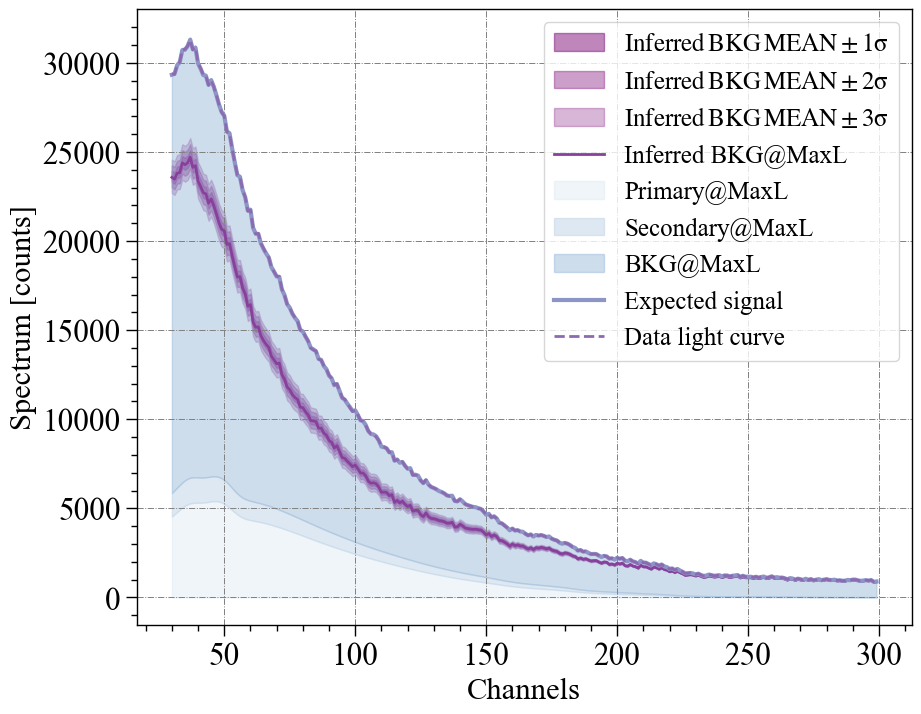

max BKG std over channels:  280.59496559058954


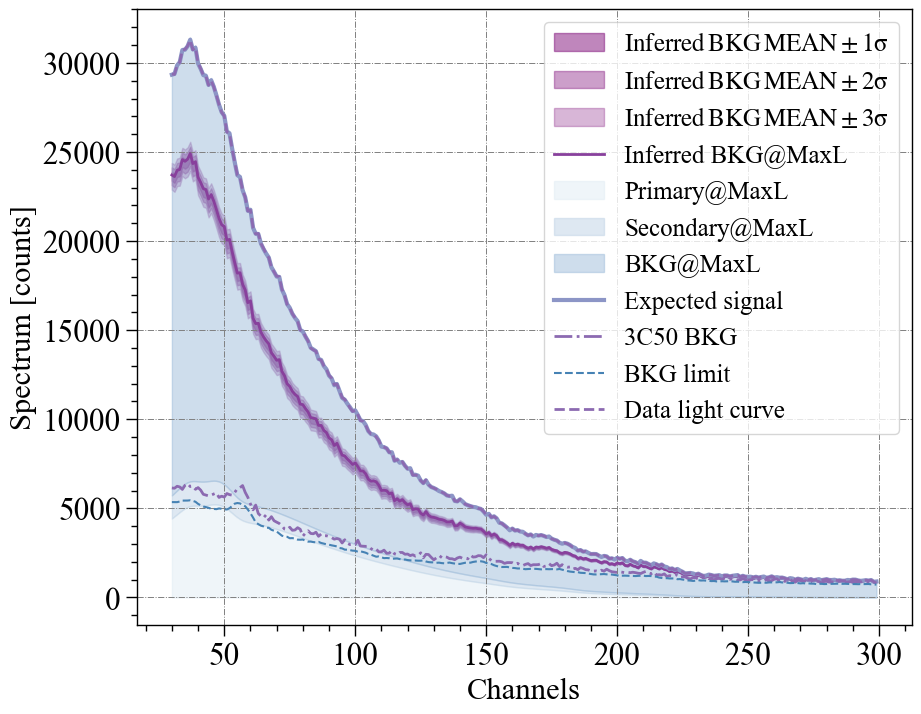

max BKG std over channels:  1136.5425442893038


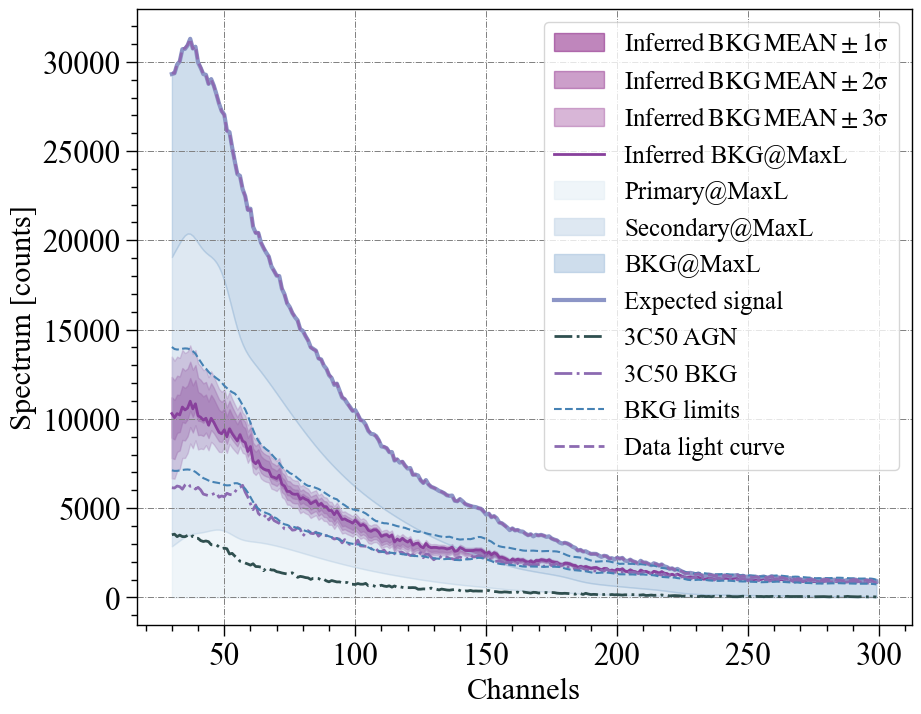

In [22]:
# Figure 7 (left)
plot_spectrum_GEN(ppm.main_3C50_NoBKG, ppm.main_3C50_NoBKG.p_maxL, ppm.PATH_dir+"/", ppm.PATH_3C50_NoBKG, './', '3C50_NoBKG', 'pdf')


plot_spectrum_GEN(ppm.main_3C50_BKG_lower_smooth_3sigma, ppm.main_3C50_BKG_lower_smooth_3sigma.p_maxL, ppm.PATH_dir+"/", ppm.PATH_3C50_BKG_lower_smooth_3sigma, './', '3C50_BKG_lower_smooth_3sigma', 'pdf', True)


# Figure 7 (right)
plot_spectrum_GEN(ppm.main_3C50_BKG_AGN_smooth_3sigma, ppm.main_3C50_BKG_AGN_smooth_3sigma.p_maxL, ppm.PATH_dir+"/", ppm.PATH_3C50_BKG_AGN_smooth_3sigma, './', '3C50_BKG_AGN_smooth_3sigma', 'pdf', True, True, True)